# Feature Creation

Feature engineering step for the project '**Aftershock pattern prediction based on earthquake rupture data for improved seismic hazard assessment**' (pred_seism_aftXYZ). DeVries18 will refer to the article 'Deep learning of aftershock patterns following large earthquakes' by Phoebe M. R. DeVries, Fernanda Viégas, Martin Wattenberg & Brendan J. Meade, and published in Nature in 2018 (https://www.nature.com/articles/s41586-018-0438-y ).

## Reproduce features of baseline model (DeVries18)

### Make balanced dataset

In [1]:
import numpy as np
import pandas as pd

df_DeVries18 = pd.read_pickle('LabelledDataset_DeVries18.pkl')
df_DeVries18.columns

Index(['x', 'y', 'z', 'stresses_full_xx', 'stresses_full_xy',
       'stresses_full_yy', 'stresses_full_xz', 'stresses_full_yz',
       'stresses_full_zz', 'stresses_full_max_shear', 'stresses_full_cfs_1',
       'stresses_full_cfs_2', 'stresses_full_cfs_3', 'stresses_full_cfs_4',
       'von_mises', 'aftershocksyn', 'ID'],
      dtype='object')

In [2]:
# unbalanced towards 0 values
df_DeVries18_1s = df_DeVries18.loc[df_DeVries18['aftershocksyn'] == 1]
df_DeVries18_0s = df_DeVries18.loc[df_DeVries18['aftershocksyn'] == 0]
numberOf0s = len(df_DeVries18_0s)
numberOf1s = len(df_DeVries18_1s)
[numberOf0s, numberOf1s, numberOf0s/(numberOf0s+numberOf1s)]

[6019888, 101322, 0.9834473903035511]

In [3]:
# subsample 0s - we use the same approach as in DeVries18 for consistency
# subsampling here reduces the number of samples from 6+ million to c. 200,000
random_subsample0 = np.random.choice(numberOf0s, numberOf1s)
df_DeVries18_0s = df_DeVries18_0s.iloc[random_subsample0]

[len(df_DeVries18_1s), len(df_DeVries18_0s)]

[101322, 101322]

In [4]:
# merge 1s and 0s
df_DeVries18_balanced = df_DeVries18_1s.append(df_DeVries18_0s)
# save balanced dataset to be used for any feature engineering
df_DeVries18_balanced.to_pickle('LabelledDataset_DeVries18_balanced.pkl')
!ls

LabelledDataset_DeVries18_balanced.pkl	None0000000.png    srcmod2.py
LabelledDataset_DeVries18.pkl		pred_seism_aftXYZ  SRCMOD_cleaned.pkl


### Feature engineering

We do the same engineering of stress features as done in DeVries18, spliting the 6 stress components into 12 (abs(stress) and -abs(stress)) and normalizing the new features by 1e6.

In [5]:
df_DeVries18_balanced = pd.read_pickle('LabelledDataset_DeVries18_balanced.pkl')

df_DeVries18_origFeatures = df_DeVries18_balanced[['stresses_full_xx', 'stresses_full_xy',
       'stresses_full_yy', 'stresses_full_xz', 'stresses_full_yz', 'stresses_full_zz',
       'aftershocksyn', 'ID']]

df_DeVries18_origFeatures.head(5)

,stresses_full_xx,stresses_full_xy,stresses_full_yy,stresses_full_xz,stresses_full_yz,stresses_full_zz,aftershocksyn,ID
14606,-5294.188338,2509.251250,-8196.672236,-2317.576445,-7106.889751,-5.014093e+03,1.0,s1968HYUGAx01YAGI
15458,-523030.424723,300396.901336,-349515.678308,-512138.483773,6140.912860,-1.149456e+06,1.0,s1968HYUGAx01YAGI
16541,-5158.974250,5385.868424,13967.913390,-1204.360283,-13219.376572,6.623055e+03,1.0,s1968HYUGAx01YAGI
19405,-1205.185919,4752.670604,-8856.723699,1164.395197,-6283.015697,-4.444154e+03,1.0,s1968HYUGAx01YAGI
20100,-100403.751663,39978.488864,-77800.154403,-159457.000564,-195934.951945,-3.305173e+05,1.0,s1968HYUGAx01YAGI


In [6]:
origFeatures = ['stresses_full_xx', 'stresses_full_xy', 'stresses_full_yy', 'stresses_full_xz', 'stresses_full_yz', 'stresses_full_zz']
posabs = ['posabsxx', 'posabsxy', 'posabsyy', 'posabsxz', 'posabsyz', 'posabszz']
negabs = ['negabsxx', 'negabsxy', 'negabsyy', 'negabsxz', 'negabsyz', 'negabszz']

df_DeVries18_engFeatures = pd.DataFrame()
df_DeVries18_engFeatures[['ID', 'aftershocksyn']] = df_DeVries18_origFeatures[['ID', 'aftershocksyn']]   #mainshock model ID and aftershock target
df_DeVries18_engFeatures[posabs] = abs(df_DeVries18_origFeatures[origFeatures]) * 1e-6
df_DeVries18_engFeatures[negabs] = -abs(df_DeVries18_origFeatures[origFeatures]) * 1e-6

df_DeVries18_engFeatures.head(5)

,ID,aftershocksyn,posabsxx,posabsxy,posabsyy,posabsxz,posabsyz,posabszz,negabsxx,negabsxy,negabsyy,negabsxz,negabsyz,negabszz
14606,s1968HYUGAx01YAGI,1.0,0.005294,0.002509,0.008197,0.002318,0.007107,0.005014,-0.005294,-0.002509,-0.008197,-0.002318,-0.007107,-0.005014
15458,s1968HYUGAx01YAGI,1.0,0.523030,0.300397,0.349516,0.512138,0.006141,1.149456,-0.523030,-0.300397,-0.349516,-0.512138,-0.006141,-1.149456
16541,s1968HYUGAx01YAGI,1.0,0.005159,0.005386,0.013968,0.001204,0.013219,0.006623,-0.005159,-0.005386,-0.013968,-0.001204,-0.013219,-0.006623
19405,s1968HYUGAx01YAGI,1.0,0.001205,0.004753,0.008857,0.001164,0.006283,0.004444,-0.001205,-0.004753,-0.008857,-0.001164,-0.006283,-0.004444
20100,s1968HYUGAx01YAGI,1.0,0.100404,0.039978,0.077800,0.159457,0.195935,0.330517,-0.100404,-0.039978,-0.077800,-0.159457,-0.195935,-0.330517


In [7]:
df_DeVries18_engFeatures.to_pickle("Features_DeVries18.pkl")
!ls

Features_DeVries18.pkl			None0000000.png    SRCMOD_cleaned.pkl
LabelledDataset_DeVries18_balanced.pkl	pred_seism_aftXYZ
LabelledDataset_DeVries18.pkl		srcmod2.py


## Define new features based on SRCMOD rupture geometry & kinematics

### Visualize possible relationships between rupture geometry and aftershock 3D pattern

Let us first visualize the geometric relationship between SRCMOD rupture and aftershock pattern. As example, let us consider the 1992 Landers case for one specific rupture model (event tag '1992LANDER01COHE'). We here want to reproduce an animation similar to the one shown in the following Google blog post: https://www.blog.google/technology/ai/forecasting-earthquake-aftershock-locations-ai-assisted-science/.

In [8]:
df_DeVries18_balanced = pd.read_pickle('LabelledDataset_DeVries18_balanced.pkl')

In [9]:
eventTag = 's1992LANDER01COHE'

# xyz cells with or without aftershocks
loc_aft_allmainshocks = df_DeVries18_balanced[['x', 'y', 'z', 'aftershocksyn', 'ID']]
loc_aft_eventTag = loc_aft_allmainshocks.loc[(loc_aft_allmainshocks['ID'] == eventTag) 
                                             & (loc_aft_allmainshocks['aftershocksyn'] == 1)]

In [10]:
SRCMOD_dictList = pd.read_pickle('SRCMOD_cleaned.pkl')

In [11]:
for i in range(len(SRCMOD_dictList)):
    if SRCMOD_dictList[i]['ID'] == eventTag:
        SRCMOD_eventTag = SRCMOD_dictList[i]

[SRCMOD_eventTag['ID'], SRCMOD_eventTag.keys()]

['s1992LANDER01COHE',
 dict_keys(['y', 'x', 'dip', 'dipMean', 'length', 'moment', 'magnitude', 'rake', 'slipStrike', 'slip', 'width', 'slipDip', 'epicenterXUtm', 'ID', 'z', 'epicenterYUtm', 'strikeMean', 'strike'])]

In [12]:
from matplotlib import pyplot as plt
from matplotlib import animation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

x_aft = loc_aft_eventTag['x']
y_aft = loc_aft_eventTag['y']
z_aft = loc_aft_eventTag['z']

x_flt = SRCMOD_eventTag['x']
y_flt = SRCMOD_eventTag['y']
z_flt = SRCMOD_eventTag['z']

slip_flt = np.asarray(SRCMOD_eventTag['slip'])
color_slip = [str(item/255.) for item in slip_flt]


fig = plt.figure()
ax = fig.gca(projection='3d')

scaled = False
if scaled:
    max_range = np.array([x_aft.max()-x_aft.min(), y_aft.max()-y_aft.min(), z_aft.max()-z_aft.min()]).max() / 2.0
    mid_x = (x_aft.max()+x_aft.min()) * 0.5
    mid_y = (y_aft.max()+y_aft.min()) * 0.5
    mid_z = (z_aft.max()+z_aft.min()) * 0.5
    ax.set_xlim(mid_x - max_range, mid_x + max_range)
    ax.set_ylim(mid_y - max_range, mid_y + max_range)
    ax.set_zlim(mid_z - max_range, mid_z + max_range)

def init():
    ax.scatter(x_aft, y_aft, z_aft, marker='s', s=20, c="red", alpha=0.2)
    ax.scatter(x_flt, y_flt, z_flt, marker='o', s=20, c=color_slip, alpha=1)
    return fig,

def animate(i):
    ax.view_init(elev=60., azim=i)
    return fig,

# Animate
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=360, interval=45, blit=True)

In [13]:
HTML(anim.to_jshtml())

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/matplotlib/animation.py:973: UserWarning: Animation size has reached 21053815 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
  " will be dropped.".format(self))


### Define new features based on geometry & kinematics

The simplest choice is to define as feature the nearest distance between aftershock cells and rupture (see animation above). Since DeVries18 found the absolute values of stress components to lead to AUC = 85%, we must identify some rupture parameters that will lead our ML algorithm to approximate, in part, those stress operations. Since stress depends on deformation, mainshock rupture slip should be a feature.

In [14]:
# existing parameters
feature_magnitude = []
feature_moment = []
feature_dipMean = []
feature_strikeMean = []
# new features
feature_mindist = []
feature_slipMean = []
feature_slipMax = []
for i in range(len(df_DeVries18_balanced)):
    if i%1e4 == 0: print(i)
    x_cell = df_DeVries18_balanced['x'].iloc[i]
    y_cell = df_DeVries18_balanced['y'].iloc[i]
    z_cell = df_DeVries18_balanced['z'].iloc[i]
    ID_cell = df_DeVries18_balanced['ID'].iloc[i]

    for j in range(len(SRCMOD_dictList)):
        if SRCMOD_dictList[j]['ID'] == ID_cell:
            #existing parameters
            feature_magnitude.append(SRCMOD_dictList[j]['magnitude'])
            feature_moment.append(SRCMOD_dictList[j]['moment'])
            feature_dipMean.append(SRCMOD_dictList[j]['dipMean'])
            feature_strikeMean.append(SRCMOD_dictList[j]['strikeMean'])
            
            #new features
            x_flt = SRCMOD_dictList[j]['x']
            y_flt = SRCMOD_dictList[j]['y']
            z_flt = SRCMOD_dictList[j]['z']
            dist2cell = np.sqrt(np.power((x_flt - x_cell), 2) + 
                                np.power((y_flt - y_cell), 2) + 
                                np.power((z_flt - z_cell), 2))
            feature_mindist.append(min(dist2cell))
            
            feature_slipMean.append(np.mean(SRCMOD_dictList[j]['slip']))
            feature_slipMax.append(np.max(SRCMOD_dictList[j]['slip']))


0
10000
20000
30000
40000
50000
60000
70000
80000
90000
100000
110000
120000
130000
140000
150000
160000
170000
180000
190000
200000


In [15]:
# merge columns to DeVries ID and target for direct comparison
df_NewFeatures = df_DeVries18_balanced[['ID', 'aftershocksyn']]  #ID and target
df_NewFeatures['mindist'] = feature_mindist
df_NewFeatures['magnitude'] = feature_magnitude
df_NewFeatures['moment'] = feature_moment
df_NewFeatures['dipMean'] = feature_dipMean
df_NewFeatures['strikeMean'] = feature_strikeMean
df_NewFeatures['slipMean'] = feature_slipMean
df_NewFeatures['slipMax'] = feature_slipMax

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentatio

In [16]:
df_NewFeatures.sample(5)

,ID,aftershocksyn,mindist,magnitude,moment,dipMean,strikeMean,slipMean,slipMax
48716,s2011TOHOKU01SATA,1.0,31066.573645,9.00,3.550000e+22,14.00,193.00000,8.019505,35.7822
15702,s2008WENCHU01YAGI,0.0,39510.229736,8.03,1.410000e+21,32.00,231.00000,3.213391,8.0090
9566,s2008WENCHU01JIxx,0.0,9881.146075,7.90,7.940000e+20,33.00,229.00000,2.785107,9.2882
23780,s2011VANUAT01HAYE,1.0,40353.849290,7.30,1.000000e+20,28.41,353.14001,0.121104,0.9326
4596,s2008WENCHU01SLAD,1.0,5162.965982,7.90,7.940000e+20,33.00,228.00000,3.761246,14.0000


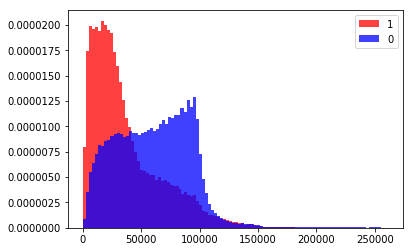

In [17]:
# plot mindist stats for binary labels
mindist_label0 = df_NewFeatures[df_NewFeatures['aftershocksyn'] == 0]['mindist']
mindist_label1 = df_NewFeatures[df_NewFeatures['aftershocksyn'] == 1]['mindist']
plt.hist(mindist_label1, 100, density=True, facecolor='r', alpha=0.75, label='1')
plt.hist(mindist_label0, 100, density=True, facecolor='b', alpha=0.75, label='0')
plt.legend(loc='upper right')
plt.show()

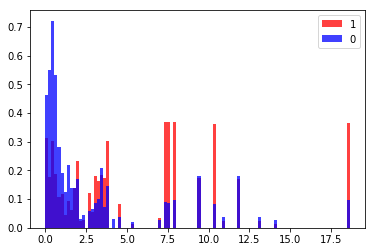

In [18]:
# plot slipMean stats for binary labels
slipMean_label0 = df_NewFeatures[df_NewFeatures['aftershocksyn'] == 0]['slipMean']
slipMean_label1 = df_NewFeatures[df_NewFeatures['aftershocksyn'] == 1]['slipMean']
plt.hist(slipMean_label1, 100, density=True, facecolor='r', alpha=0.75, label='1')
plt.hist(slipMean_label0, 100, density=True, facecolor='b', alpha=0.75, label='0')
plt.legend(loc='upper right')
plt.show()

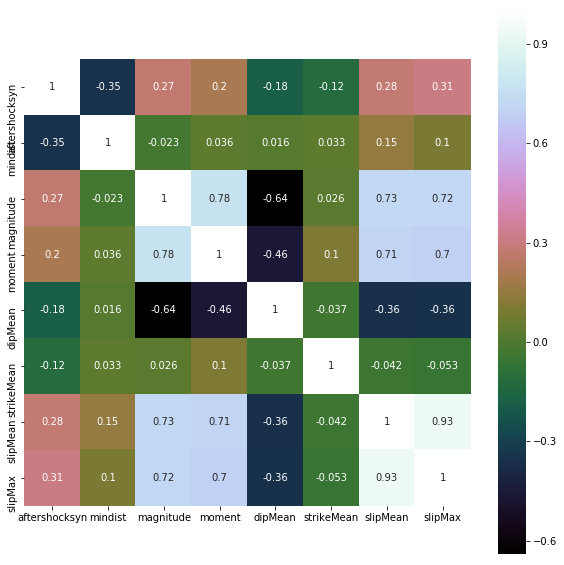

In [19]:
import seaborn as sns

correlation = df_NewFeatures.corr()
plt.figure(figsize=(10, 10))  
sns.heatmap(correlation, annot=True, square=True, cmap='cubehelix')

In [20]:
len(df_NewFeatures)*0.005

1013.22

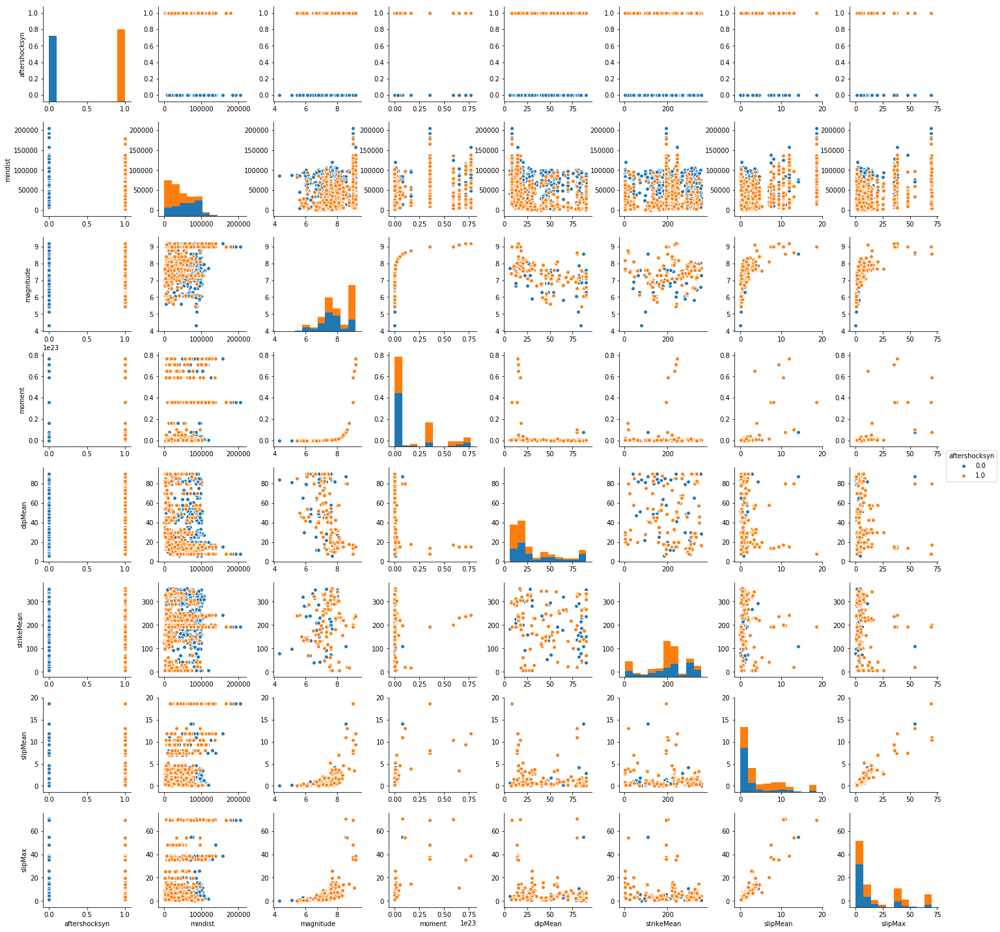

In [21]:
df_sample = df_NewFeatures.sample(frac=0.005)
pplot = sns.pairplot(df_sample, hue='aftershocksyn') 

In [22]:
df_x = df_NewFeatures[['mindist', 'slipMean']]
min_mindist = 0
max_mindist = 300000
min_slipMean = 0
max_slipMean = 20
[min(df_x['mindist']), max(df_x['mindist']), min(df_x['slipMean']), max(df_x['slipMean'])]

[111.64821990019483,
 260804.36485495215,
 0.012294909688013137,
 18.63509090909091]

In [23]:
# select features & normalise
df_x_norm = df_x
df_x_norm['mindist'] = (df_x_norm['mindist']-min_mindist)/(max_mindist-min_mindist)
df_x_norm['slipMean'] = (df_x_norm['slipMean']-min_slipMean)/(max_slipMean-min_slipMean)

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()
/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [24]:
df_NewFeatures_norm = df_x_norm
df_NewFeatures_norm[['ID', 'aftershocksyn']] = df_NewFeatures[['ID', 'aftershocksyn']]
df_NewFeatures_norm.sample(5)

/opt/conda/envs/DSX-Python35/lib/python3.5/site-packages/pandas/core/frame.py:2540: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]


,mindist,slipMean,ID,aftershocksyn
1130,0.053296,0.047525,s2010ELMAYO01WEIx,0.0
1010,0.062811,0.023750,s2003TOKACH01TANI,0.0
19624,0.270896,0.137166,s1999CHICHI01CHIx,0.0
4081,0.237497,0.375050,s2011TOHOKU02FUJI,1.0
4012,0.135851,0.400975,s2011TOHOKU01SATA,0.0


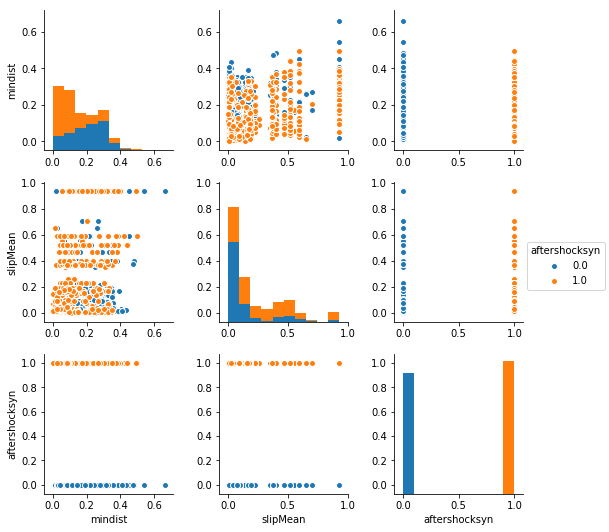

In [25]:
# check final set of features
df_sample = df_NewFeatures_norm.sample(frac=0.005)  
pplot = sns.pairplot(df_sample, hue='aftershocksyn')

In [26]:
df_NewFeatures_norm.to_pickle("Features_new.pkl")
!ls

Features_DeVries18.pkl			None0000000.png
Features_new.pkl			pred_seism_aftXYZ
LabelledDataset_DeVries18_balanced.pkl	srcmod2.py
LabelledDataset_DeVries18.pkl		SRCMOD_cleaned.pkl
